<a href="https://colab.research.google.com/github/MickaRiv/ProjetDatascientest-VoiceSeparator/blob/Mickael/notebooks/metrics.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install nussl

In [ ]:
!pip install git+https://github.com/MickaRiv/ProjetDatascientest-VoiceSeparator

In [ ]:
import os
import nussl
import librosa
from matplotlib import pyplot as plt
import numpy as np
import concurrent.futures
import time
from glob import glob

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:
def preprocess(music_data,
               freq=8192,
               window_length=1023,
               hop_length=768,
               normalize=True):
  
  # Spectro voix et mix
  voice = music_data['sources']["vocals"]
  mix = music_data['mix']

  # Resampling à 16 kHz (pour data plus light)
  if freq is not None:
    voice.resample(freq,res_type='kaiser_fast')
    mix.resample(freq,res_type='kaiser_fast')

  # Passage en mono
  voice.to_mono()
  mix.to_mono()

  # fft mix et voix (magnitude normalisée et phase)
  stftvoice = voice.stft(window_length=window_length,hop_length=hop_length)
  magvoice, phasevoice = librosa.magphase(stftvoice)

  stftmix = mix.stft(window_length=window_length,hop_length=hop_length)
  magmix, phasemix = librosa.magphase(stftmix)

  if normalize:
    norm = magmix.max()
    magmix /= norm
    magvoice /= norm
    return magmix, magvoice, phasemix, norm

  return magmix, magvoice, phasemix

In [41]:
def reshape(X_mix, X_voice, patch_size=128, extend=False):
  # transposition pour mettre le temps en première composante  
  X_mix = X_mix.T
  X_voice = X_voice.T

  if extend:
    # split en "images" temporelles de taille patch_size (128 dans le papier d'origine)
    nimages = int(np.ceil(X_mix.shape[0]/patch_size))   # nombre total d'images
    newsize = nimages*patch_size           # nouvelle taille pour un découpage qui tombe juste 

    X_mix_resized = np.concatenate((X_mix,np.zeros((newsize-X_mix.shape[0],X_mix.shape[1]))))
    X_voice_resized = np.concatenate((X_voice,np.zeros((newsize-X_voice.shape[0],X_voice.shape[1]))))
  else:
    # split en "images" temporelles de taille patch_size (128 dans le papier d'origine)
    nimages = X_mix.shape[0]//patch_size   # nombre total d'images
    newsize = nimages*patch_size           # nouvelle taille pour un découpage qui tombe juste 

    X_mix_resized = X_mix[:newsize]
    X_voice_resized = X_voice[:newsize]

  X_mix = np.array(np.split(X_mix_resized, nimages, axis=0))    # découpage 
  X_voice = np.array(np.split(X_voice_resized, nimages, axis=0))

  X_mix = np.expand_dims(X_mix,axis=3) # rajout d'une dimension (canal) 
  X_voice = np.expand_dims(X_voice,axis=3)

  return X_mix, X_voice

In [ ]:
from voicesep.core import get_musdb_data

path = os.path.join("/content",
                    "drive",
                    "MyDrive",
                    "Projet Datascientest",
                    "musdb18")
musdb = get_musdb_data(gather_accompaniment=True,folder=path)
musdb_train = get_musdb_data(gather_accompaniment=True,folder=path,subfolder="train")
musdb_test = get_musdb_data(gather_accompaniment=True,folder=path,subfolder="test")

In [35]:
from tensorflow.keras.models import load_model
import tensorflow as tf

models = glob(os.path.join("/content","drive","MyDrive","Projet Datascientest","UNet","model*"))
print(models)
i = 3
print(models[i])
def myloss(y_true, y_pred):
  return tf.math.reduce_sum(abs(y_true - y_pred)) + abs(tf.math.reduce_sum(y_true) - tf.math.reduce_sum(y_pred))
unet = load_model(models[i], custom_objects={'myloss': myloss})

['/content/drive/MyDrive/Projet Datascientest/UNet/model_20220122_8389ac2af3ba2c49', '/content/drive/MyDrive/Projet Datascientest/UNet/model_20220124_empty', '/content/drive/MyDrive/Projet Datascientest/UNet/model_20220127_keep_all', '/content/drive/MyDrive/Projet Datascientest/UNet/model_20220127_long_train_sd+ds', '/content/drive/MyDrive/Projet Datascientest/UNet/model_20220101_init', '/content/drive/MyDrive/Projet Datascientest/UNet/model_20220124_test', '/content/drive/MyDrive/Projet Datascientest/UNet/model_20220126_init2', '/content/drive/MyDrive/Projet Datascientest/UNet/model_20220125_sd+ds']
/content/drive/MyDrive/Projet Datascientest/UNet/model_20220127_long_train_sd+ds


(512, 2241, 1)
(17, 128, 512, 1)
AudioSignal (unlabeled): 209.908 sec @ AM Contra - Heart Peripheral, 8192 Hz, 1 ch.


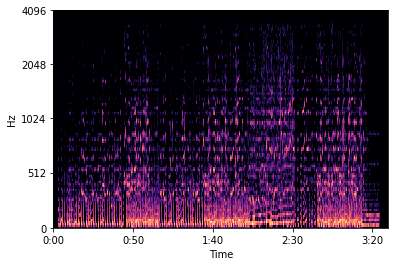

AudioSignal (unlabeled): 209.908 sec @ musdb/AM Contra - Heart Peripheral_vocals.wav, 8192 Hz, 1 ch.


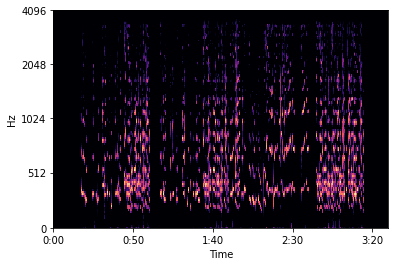

(17, 128, 512, 1)
(512, 2176, 1)
AudioSignal (unlabeled): 203.906 sec @ path unknown, 8192 Hz, 1 ch.


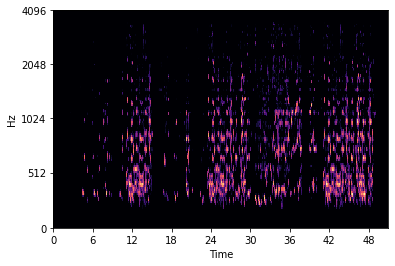

In [36]:
data = musdb_test[0]

# ATTENTION A UTILISER LES BONS
window_length = 1023
hop_length = 768

magmix, magvoice, phase, norm = preprocess(data)
print(magmix.shape)
X_mix, X_voice = reshape(magmix[:,:,0], magvoice[:,:,0], 128)
print(X_mix.shape)

print(data["mix"])
data["mix"].embed_audio()
nussl.utils.visualize_spectrogram(data["mix"], y_axis='mel')
plt.show()

print(data["sources"]["vocals"])
data["sources"]["vocals"].embed_audio()
nussl.utils.visualize_spectrogram(data["sources"]["vocals"], y_axis='mel')
plt.show()

X_voice_pred = unet.predict(X_mix)
print(X_voice_pred.shape)
magmix_pred = X_voice_pred.reshape(-1,512,1).transpose(1,0,2)
print(magmix_pred.shape)
end = magmix_pred.shape[1]
audio_pred = nussl.AudioSignal(stft=magmix_pred*norm*phase[:,:end],sample_rate=8192)
audio_pred.istft(window_length=window_length,hop_length=hop_length)
print(audio_pred)
audio_pred.embed_audio()
nussl.utils.visualize_spectrogram(audio_pred, y_axis='mel')
plt.show()



In [49]:
def preprocess_mix(mix,
                   freq=8192,
                   window_length=1023,
                   hop_length=768,
                   normalize=True):

  # Resampling à 16 kHz (pour data plus light)
  if freq is not None:
    mix.resample(freq,res_type='kaiser_fast')

  # Passage en mono
  mix.to_mono()

  # fft mix et voix (magnitude normalisée et phase)
  stftmix = mix.stft(window_length=window_length,hop_length=hop_length)
  magmix, phasemix = librosa.magphase(stftmix)

  if normalize:
    norm = magmix.max()
    magmix /= norm
    return magmix, phasemix, norm

  return magmix, phasemix

In [50]:
def reshape_mix(X_mix, patch_size=128, extend=False):
  # transposition pour mettre le temps en première composante  
  X_mix = X_mix.T

  if extend:
    # split en "images" temporelles de taille patch_size (128 dans le papier d'origine)
    nimages = int(np.ceil(X_mix.shape[0]/patch_size))   # nombre total d'images
    newsize = nimages*patch_size           # nouvelle taille pour un découpage qui tombe juste 

    X_mix_resized = np.concatenate((X_mix,np.zeros((newsize-X_mix.shape[0],X_mix.shape[1]))))
  else:
    # split en "images" temporelles de taille patch_size (128 dans le papier d'origine)
    nimages = X_mix.shape[0]//patch_size   # nombre total d'images
    newsize = nimages*patch_size           # nouvelle taille pour un découpage qui tombe juste 

    X_mix_resized = X_mix[:newsize]

  X_mix = np.array(np.split(X_mix_resized, nimages, axis=0))    # découpage 

  X_mix = np.expand_dims(X_mix,axis=3) # rajout d'une dimension (canal) 

  return X_mix

(512, 2241, 1)
(18, 128, 512, 1)
AudioSignal (unlabeled): 209.908 sec @ AM Contra - Heart Peripheral, 8192 Hz, 1 ch.


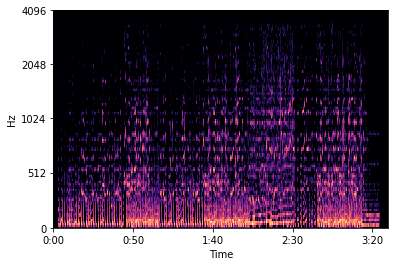

AudioSignal (unlabeled): 209.908 sec @ musdb/AM Contra - Heart Peripheral_vocals.wav, 8192 Hz, 1 ch.


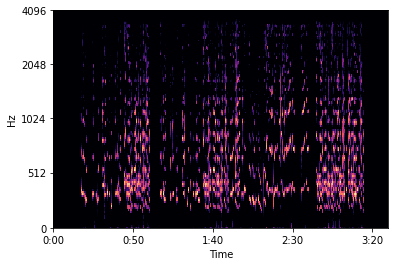

/usr/local/lib/python3.7/dist-packages/nussl/core/audio_signal.py:1485: UserWarning: Cannot resample to the same sample rate.
  warnings.warn('Cannot resample to the same sample rate.')


AudioSignal (unlabeled): 209.908 sec @ path unknown, 8192 Hz, 1 ch.


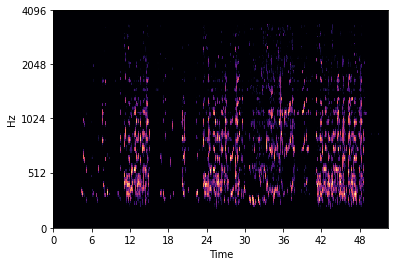

In [67]:
data = musdb_test[0]

# ATTENTION A UTILISER LES BONS
window_length = 1023
hop_length = 768

magmix, magvoice, phase, norm = preprocess(data)
print(magmix.shape)
X_mix, X_voice = reshape(magmix[:,:,0], magvoice[:,:,0], 128, extend=True)
print(X_mix.shape)

print(data["mix"])
data["mix"].embed_audio()
nussl.utils.visualize_spectrogram(data["mix"], y_axis='mel')
plt.show()

print(data["sources"]["vocals"])
data["sources"]["vocals"].embed_audio()
nussl.utils.visualize_spectrogram(data["sources"]["vocals"], y_axis='mel')
plt.show()

class UNetModel:
  window_length = 1023
  hop_length = 768
  def __init__(self,mix,model):
    self.mix = mix
    self.model = model
  def __call__(self):
    magmix, phase, norm = preprocess_mix(self.mix)
    X_mix = reshape_mix(magmix[:,:,0], 128, extend=True)
    X_voice_pred = self.model.predict(X_mix)
    magmix_pred = X_voice_pred.reshape(-1,512,1).transpose(1,0,2)
    end = magmix.shape[1]
    audio_pred = nussl.AudioSignal(stft=magmix_pred[:,:end]*norm*phase,sample_rate=8192)
    audio_pred.istft(window_length=window_length,hop_length=hop_length)
    audio_pred.truncate_seconds(self.mix.signal_duration)
    return [audio_pred*2,audio_pred]

unet_model = UNetModel(data["mix"],unet)
audio_pred = unet_model()[1]
print(audio_pred)
audio_pred.embed_audio()
nussl.utils.visualize_spectrogram(audio_pred, y_axis='mel')
plt.show()


/usr/local/lib/python3.7/dist-packages/nussl/core/audio_signal.py:1485: UserWarning: Cannot resample to the same sample rate.
  warnings.warn('Cannot resample to the same sample rate.')


AudioSignal (unlabeled): 209.908 sec @ drums+bass+other, 8192 Hz, 1 ch.


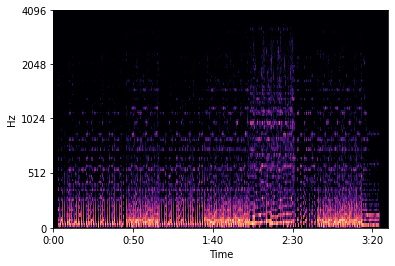

AudioSignal (unlabeled): 209.908 sec @ musdb/AM Contra - Heart Peripheral_vocals.wav, 8192 Hz, 1 ch.


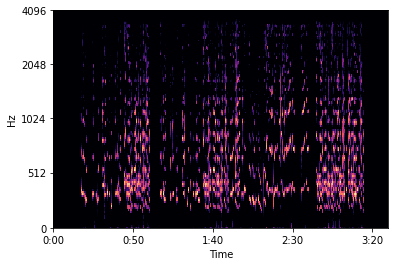

/content/drive/MyDrive/Projet Datascientest/UNet/model_20220122_stany
pass
/content/drive/MyDrive/Projet Datascientest/UNet/model_20220124_empty
/content/drive/MyDrive/Projet Datascientest/UNet/model_20220127_keep_all
/content/drive/MyDrive/Projet Datascientest/UNet/model_20220127_long_train_sd+ds
/content/drive/MyDrive/Projet Datascientest/UNet/model_20220101_init
/content/drive/MyDrive/Projet Datascientest/UNet/model_20220124_test
/content/drive/MyDrive/Projet Datascientest/UNet/model_20220126_init2
/content/drive/MyDrive/Projet Datascientest/UNet/model_20220125_sd+ds


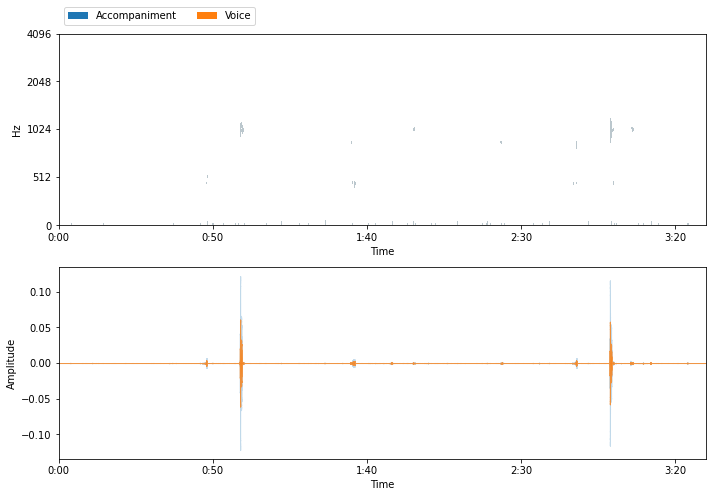


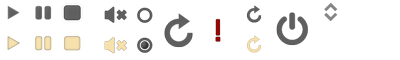
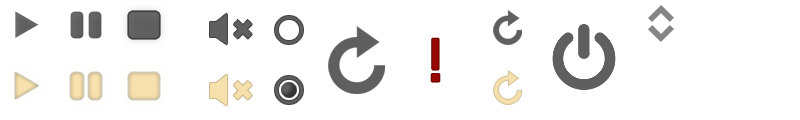
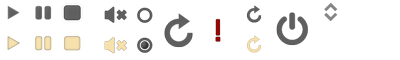

---------------------------------------------
accompaniment SI-SDR: -64.59 dB
accompaniment SI-SIR: -41.49 dB
accompaniment SI-SAR: -64.57 dB

voice SI-SDR: -23.09 dB
voice SI-SIR: 41.16 dB
voice SI-SAR: -23.09 dB




/usr/local/lib/python3.7/dist-packages/nussl/core/audio_signal.py:1485: UserWarning: Cannot resample to the same sample rate.
  warnings.warn('Cannot resample to the same sample rate.')


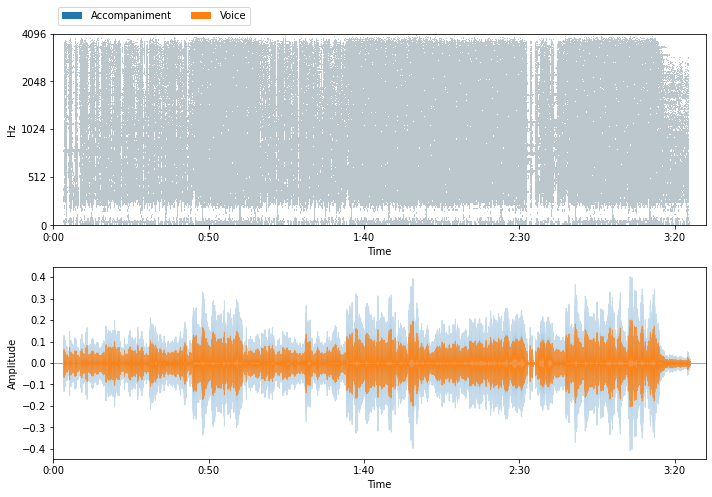


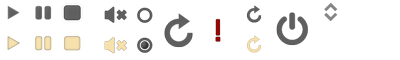
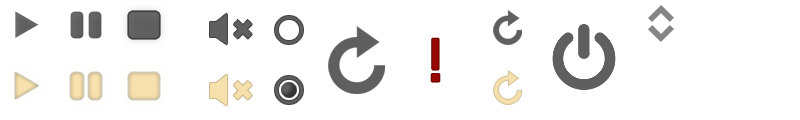
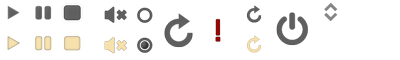

---------------------------------------------
accompaniment SI-SDR: -17.40 dB
accompaniment SI-SIR: -15.98 dB
accompaniment SI-SAR: -11.86 dB

voice SI-SDR: 3.84 dB
voice SI-SIR: 15.96 dB
voice SI-SAR: 4.12 dB




/usr/local/lib/python3.7/dist-packages/nussl/core/audio_signal.py:1485: UserWarning: Cannot resample to the same sample rate.
  warnings.warn('Cannot resample to the same sample rate.')


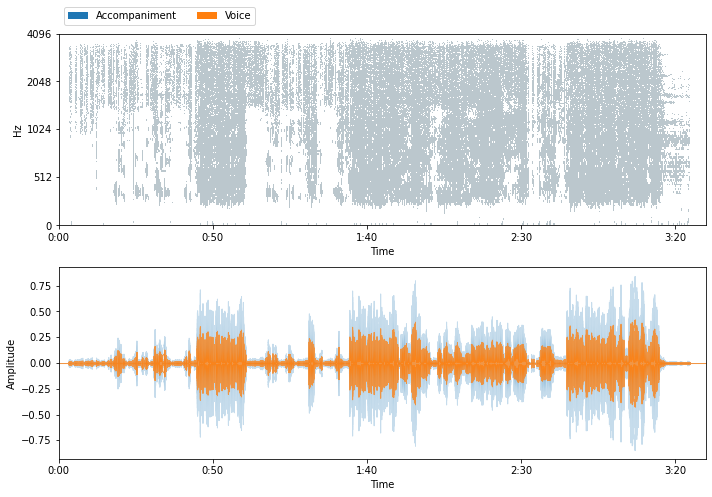


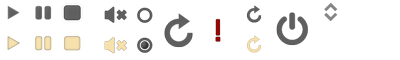
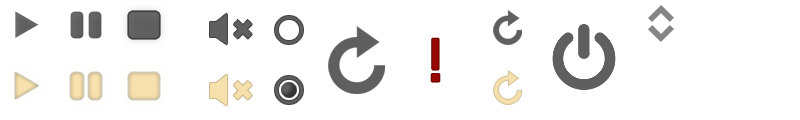
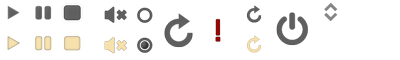

---------------------------------------------
accompaniment SI-SDR: -25.21 dB
accompaniment SI-SIR: -24.07 dB
accompaniment SI-SAR: -18.84 dB

voice SI-SDR: 5.17 dB
voice SI-SIR: 24.02 dB
voice SI-SAR: 5.23 dB




/usr/local/lib/python3.7/dist-packages/nussl/core/audio_signal.py:1485: UserWarning: Cannot resample to the same sample rate.
  warnings.warn('Cannot resample to the same sample rate.')


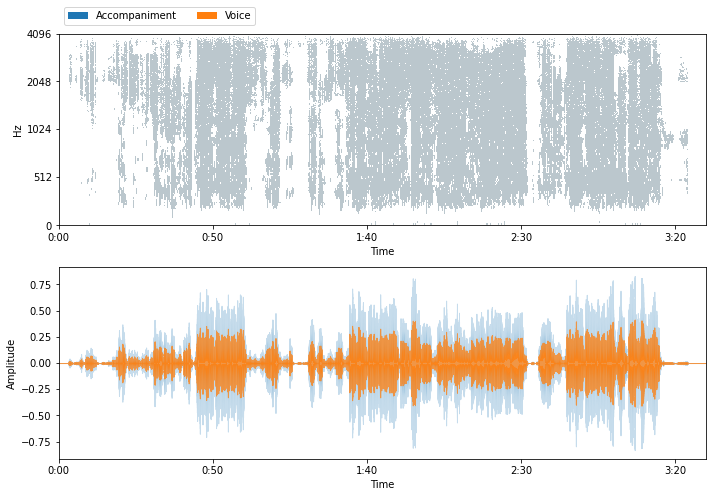


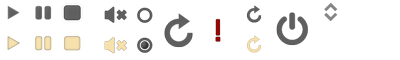
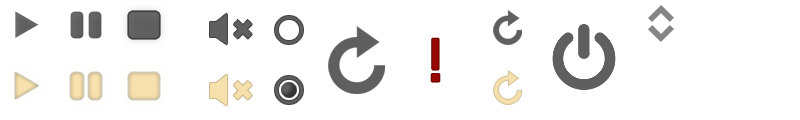
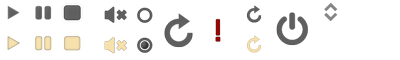

---------------------------------------------
accompaniment SI-SDR: -22.99 dB
accompaniment SI-SIR: -21.79 dB
accompaniment SI-SAR: -16.84 dB

voice SI-SDR: 4.85 dB
voice SI-SIR: 21.75 dB
voice SI-SAR: 4.94 dB




/usr/local/lib/python3.7/dist-packages/nussl/core/audio_signal.py:1485: UserWarning: Cannot resample to the same sample rate.
  warnings.warn('Cannot resample to the same sample rate.')


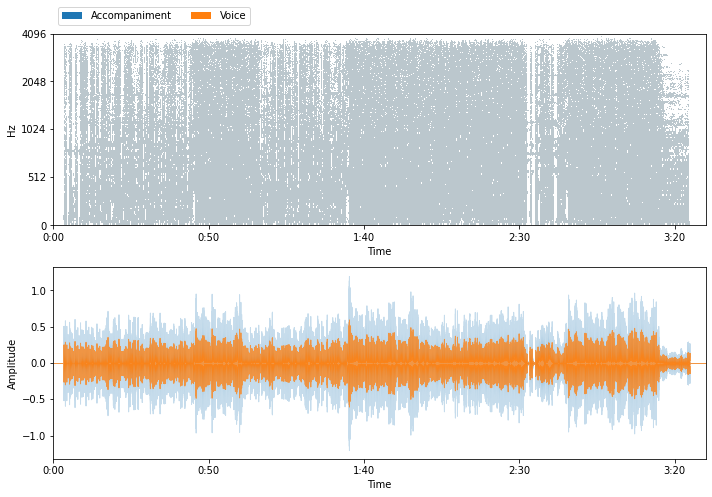


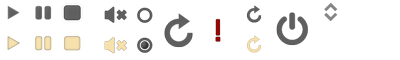
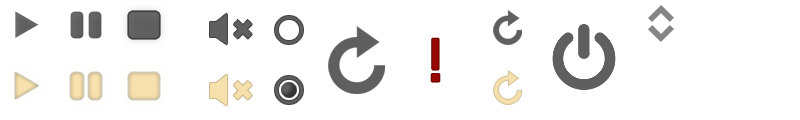
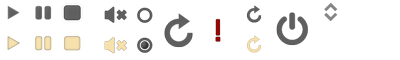

---------------------------------------------
accompaniment SI-SDR: -6.14 dB
accompaniment SI-SIR: -4.82 dB
accompaniment SI-SAR: -0.34 dB

voice SI-SDR: 1.63 dB
voice SI-SIR: 4.82 dB
voice SI-SAR: 4.48 dB




/usr/local/lib/python3.7/dist-packages/nussl/core/audio_signal.py:1485: UserWarning: Cannot resample to the same sample rate.
  warnings.warn('Cannot resample to the same sample rate.')


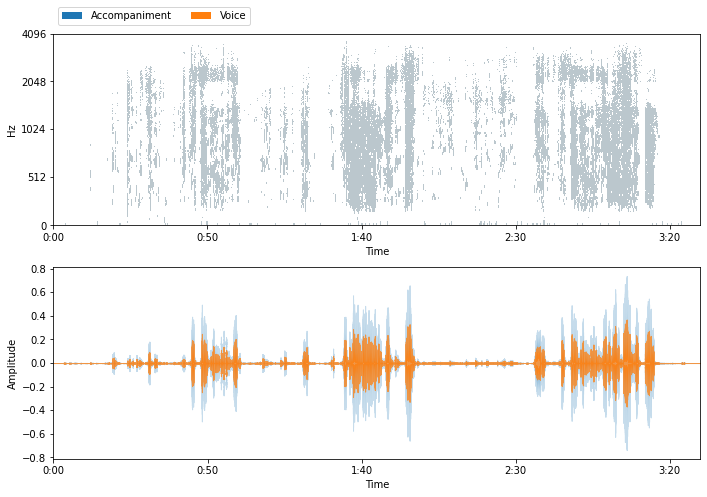


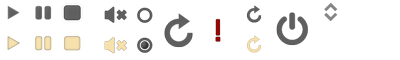
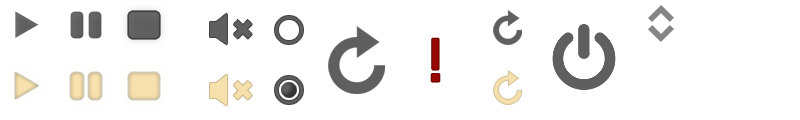
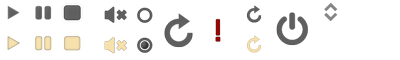

---------------------------------------------
accompaniment SI-SDR: -33.29 dB
accompaniment SI-SIR: -28.71 dB
accompaniment SI-SAR: -31.43 dB

voice SI-SDR: -2.73 dB
voice SI-SIR: 28.63 dB
voice SI-SAR: -2.73 dB




/usr/local/lib/python3.7/dist-packages/nussl/core/audio_signal.py:1485: UserWarning: Cannot resample to the same sample rate.
  warnings.warn('Cannot resample to the same sample rate.')


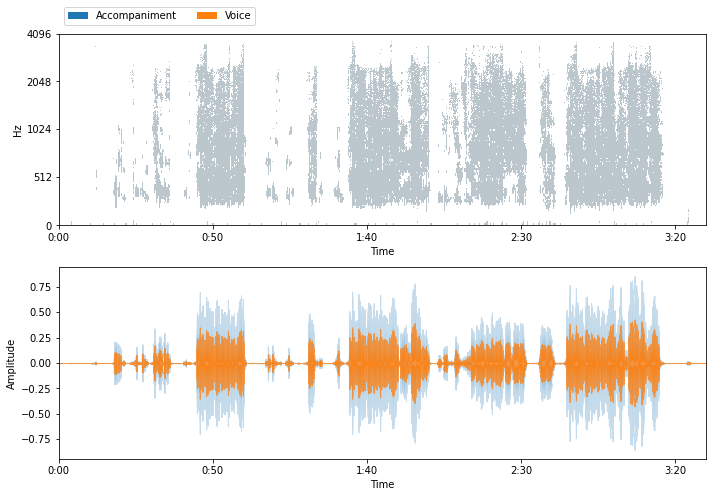


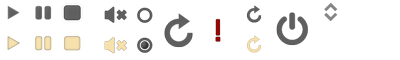
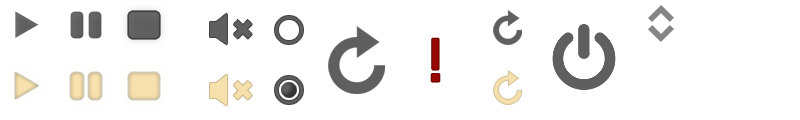
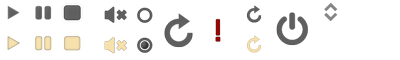

---------------------------------------------
accompaniment SI-SDR: -26.79 dB
accompaniment SI-SIR: -25.54 dB
accompaniment SI-SAR: -20.78 dB

voice SI-SDR: 4.72 dB
voice SI-SIR: 25.48 dB
voice SI-SAR: 4.76 dB




In [72]:
from voicesep.models import evaluate_dict_models
truth = [data["sources"]['drums+bass+other'], data["sources"]['vocals']]
truth[0].resample(8192,res_type='kaiser_fast')
truth[1].resample(8192,res_type='kaiser_fast')
truth[0].to_mono()
truth[1].to_mono()
print(truth[0])
nussl.utils.visualize_spectrogram(truth[0], y_axis='mel')
plt.show()
print(truth[1])
nussl.utils.visualize_spectrogram(truth[1], y_axis='mel')
plt.show()
models = glob(os.path.join("/content","drive","MyDrive","Projet Datascientest","UNet","model*"))
unets=[]
for m in models:
  try:
    print(m)
    if "stany" in m:
      print("pass")
      continue
    unets.append(load_model(m, custom_objects={'myloss': myloss}))
  except:
    print("error")
sep_class_dict = {
                  f"UNet{i}": UNetModel(data["mix"],u) for i,u in enumerate(unets)
                 }
scores = evaluate_dict_models(sep_class_dict, truth)